In [72]:
import pandas as pd

In [73]:
patches = pd.read_csv('patches.csv', header=None)
patches.columns = ['tick', 'pID', 'properties', 'occupied', 'density', 'zID', 'nID', 'p-age', 'psize', 'ptype', 'price', 'PR', 'CR', 'Rent-gap', 'pcolor']

In [74]:
patches.shape

(8928621, 15)

In [75]:
patches.head()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
0,0,19517,0,False,0.086705,90.0,40.0,58,1538.325460,S,165098.550768,1474.870240,144.940787,0.901726,3.0
1,0,18418,0,False,0.000000,30.0,4.0,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
2,0,5492,0,False,0.135246,90.0,67.0,36,2500.057538,S,578360.583731,2041.498838,483.687744,0.763072,3.0
3,0,39588,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
4,0,2126,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0


In [76]:
patches.tail()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
8928616,220,13337,0,False,0.260638,60.0,120.0,29,938.092054,C,556526.801815,1309.715156,410.577602,0.686514,115.0
8928617,220,36786,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
8928618,220,39226,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
8928619,220,32541,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
8928620,220,19180,0,False,0.000000,30.0,6.0,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0


In [79]:
turtles = pd.read_csv('turtles.csv', header=None)
turtles.columns = ['tick', 'tID', 'budget', 'ttype', 'income', 'housing', 'saving', 'lowerbound', 'upperbound', 'happy', 'pID', 'similar-color', 'similar-income', 'NOI', 'near-CBD', 'low-rent']

In [80]:
turtles.shape

(1032432, 16)

In [81]:
turtles.head()

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,pID,similar-color,similar-income,NOI,near-CBD,low-rent
0,0,862,102991.108022,pro,149262.475395,-705597.582159,138814.102117,117086,158542,false,2735,14,1,0.0,0,0
1,0,2065,39948.806481,nonpro,57896.820987,-438193.876097,53844.043518,31876,53752,false,28624,12,2,0.0,1,0
2,0,965,94986.503029,pro,137661.598593,-416707.841637,128025.286691,117086,158542,false,27674,6,0,0.0,1,0
3,0,971,110109.779976,pro,159579.391269,-944683.415072,148408.833880,117086,158542,false,21487,15,1,0.0,1,0
4,0,2217,26050.100238,nonpro,37753.768461,352069.788947,35111.004668,31876,53752,false,12977,19,5,0.0,1,1


In [82]:
#turtles[(turtles['tID']==623)][['tick','pID']]

In [83]:
merged = turtles.merge(patches, on=['pID','tick'])

In [84]:
#merged[(merged['tID']==623)][['tick','pID','nID']]

In [85]:
from collections import defaultdict

In [86]:
group = merged.groupby('tID')

In [87]:
# nonpros that have moved to zID 60 neighborhoods from any neighborhood in any zID in every tick
nonpros_per_tick = {}
for key, g in group:
    #print(key, g['ttype'].values[0])
    nIDs = g['nID'].values
    moved = [t+1 for t,(i,j) in enumerate(zip(nIDs, nIDs[1:])) if i!=j]
    #print('nID', nIDs)
    #print(moved)
    if g['ttype'].values[0] == 'nonpro' and g['zID'].values[0]==60:
        for tick in moved:
            if tick in nonpros_per_tick:
                nonpros_per_tick[tick]+=1
            else:
                nonpros_per_tick[tick]=1
    #print('zID', g['zID'].values)
    #print('**************************************')

In [88]:
# sorting based on tick
nonpros_per_tick = sorted(nonpros_per_tick.items(), key=lambda x: x[0])

In [89]:
#nonpros and pros who have interest to live near CBD and pay low rent
nonpros = []
pros = []
group = merged.groupby('tick')
for key, g in group:
    nonpro, pro = g[(g['near-CBD']==1) & (g['low-rent']==1)]['ttype'].value_counts().values
    #print('key: {}, number of nonpros: {}, number of pros: {}'.format(key, nonpro, pro))
    nonpros.append(nonpro)
    pros.append(pro)

# Gentrification by Demand

In [90]:
import matplotlib.pylab as plt
import numpy as np
import os

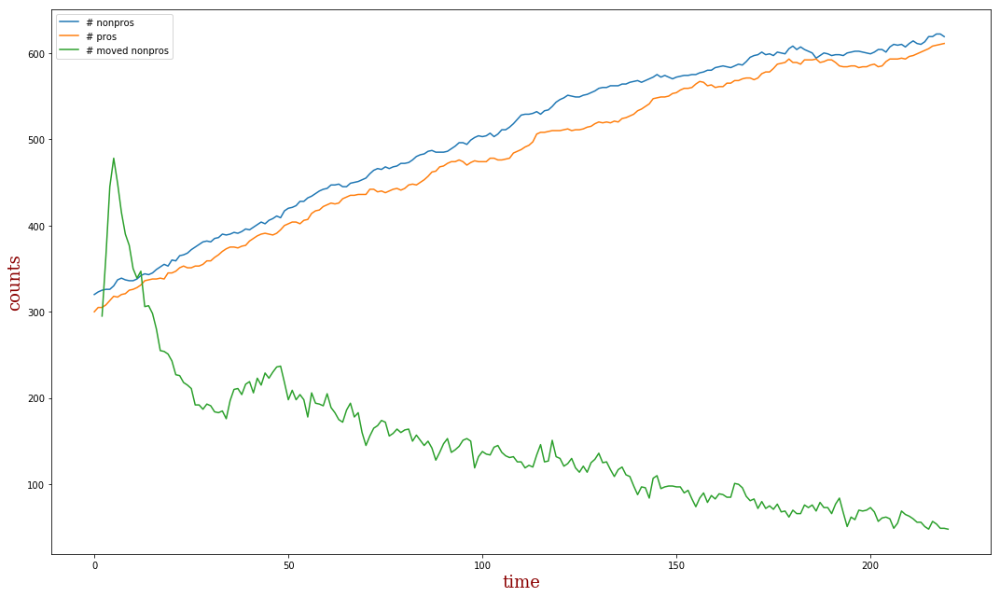

In [91]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 18,
        }
n = len(nonpros)
fig = plt.figure(figsize=(15,9))
ax = fig.add_subplot(1,1,1)
# pros and nonpros population for near CBD and low rent
ax.plot(range(n-1), nonpros[1:])
ax.plot(range(n-1), pros[1:])
# moved nonpros
ax.plot([_[0] for _ in nonpros_per_tick][1:], [_[1] for _ in nonpros_per_tick][1:])
ax.legend(['# nonpros', '# pros', '# moved nonpros'])
ax.set_xlabel('time',fontdict=font)
ax.set_ylabel('counts',fontdict=font)

plt.tight_layout()
plt.show()

In [92]:
merged.head()

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,...,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
0,0,862,102991.108022,pro,149262.475395,-705597.582159,138814.102117,117086,158542,false,...,90.0,27.0,69,2048.579213,S,153045.887770,1958.423400,123.952080,0.936708,3.0
1,0,2065,39948.806481,nonpro,57896.820987,-438193.876097,53844.043518,31876,53752,false,...,60.0,127.0,50,933.866212,C,190888.431898,1227.750556,166.157969,0.864665,3.0
2,0,965,94986.503029,pro,137661.598593,-416707.841637,128025.286691,117086,158542,false,...,60.0,97.0,70,973.915468,C,92082.448605,1292.152051,78.575847,0.939190,3.0
3,0,971,110109.779976,pro,159579.391269,-944683.415072,148408.833880,117086,158542,false,...,90.0,71.0,56,1466.938844,S,328596.901251,2564.326589,272.994373,0.893541,3.0
4,0,2217,26050.100238,nonpro,37753.768461,352069.788947,35111.004668,31876,53752,false,...,60.0,98.0,69,947.709836,C,88798.708769,1170.843653,74.104765,0.936708,3.0


In [93]:
merged.columns

Index(['tick', 'tID', 'budget', 'ttype', 'income', 'housing', 'saving',
       'lowerbound', 'upperbound', 'happy', 'pID', 'similar-color',
       'similar-income', 'NOI', 'near-CBD', 'low-rent', 'properties',
       'occupied', 'density', 'zID', 'nID', 'p-age', 'psize', 'ptype', 'price',
       'PR', 'CR', 'Rent-gap', 'pcolor'],
      dtype='object')

In [94]:
group = merged.groupby(['nID', 'tick'])

In [95]:
# nonpros that have moved to zID 60 neighborhoods from any neighborhood in any zID in every tick
stat_nonpro = defaultdict(list)
stat_pro = defaultdict(list)
patch_info = defaultdict(list)
for (key,tick), g in group:
    nonpros = g[g.ttype=='nonpro']
    pros = g[g.ttype=='pro']
    nnonpros = nonpros.shape[0]
    npros = pros.shape[0]
    nonpros_happy = dict(zip(nonpros.happy.value_counts().keys(), nonpros.happy.value_counts().values))
    pros_happy = dict(zip(pros.happy.value_counts().keys(), pros.happy.value_counts().values))
    stat_nonpro[key].append({'tick':tick, 
                             'avg_savings':nonpros['housing'].mean(), 
                             'counts': nonpros.shape[0],
                            'nhappy': nonpros_happy['true'] if 'true' in nonpros_happy else 0,
                            'percentage_happy': float(nonpros_happy['true'])/nnonpros if 'true' in nonpros_happy else 0})
    stat_pro[key].append({'tick':tick, 
                          'avg_savings':pros['housing'].mean(), 
                          'counts': pros.shape[0],
                        'nhappy': pros_happy['true'] if 'true' in pros_happy else 0,
                        'percentage_happy': float(pros_happy['true'])/npros if 'true' in pros_happy else 0})
    patch_info[key].append({'tick':tick, 'housing_price':g.price.mean(), 'density':g.density.values[0]})

# Gentrification by Supply

### All patches that are developed by a developer

In [146]:
dev_patches = patches[(patches.occupied == False) & (patches['p-age']==1) & (patches['tick']>0) & (patches['pcolor']!=3)]

In [149]:
dev_patches.head()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
40621,1,9174,0,False,0.104895,90.0,72.0,1,1267.109578,S,2.462363e+06,2209.385422,2122.754180,0.039211,45.0
40847,1,28594,0,False,0.121387,90.0,60.0,1,2367.496403,S,2.601841e+06,2296.347882,2206.306793,0.039211,45.0
40987,1,24307,0,False,0.151751,90.0,54.0,1,1724.240764,S,2.574136e+06,2203.949445,2117.531351,0.039211,45.0
41092,1,16922,0,False,0.064103,90.0,82.0,1,927.087971,S,2.258741e+06,2111.065786,2028.289712,0.039211,45.0
41417,1,28085,0,False,0.107914,90.0,97.0,1,929.550597,S,2.046491e+06,1830.704657,1758.921701,0.039211,5.0


In [177]:
mgroup = merged.groupby('nID')
dgroup = dev_patches.groupby('nID')

pros_bought_house = {}
nonpros_bought_house = {}
pros_bought_house_by_nid = {}
nonpros_bought_house_by_nid = {}

for nid, g in dgroup:
    for pid in set(g.pID.values):
        renovated_years_ticks = g[(g.pID==pid)]['tick'].values
        owned_by_agent_ticks = merged[merged.pID == pid]['tick'].values
        agent_at_pid = merged[merged.pID == pid]
        if len(owned_by_agent_ticks)==0: continue
        moved = [owned_by_agent_ticks[0]]+[j for (i,j) in zip(owned_by_agent_ticks, owned_by_agent_ticks[1:]) if (i+1)!=j]
        #print(nid, pid)
        #print(renovated_years_ticks)
        #print(owned_by_agent_ticks)
        #print(moved)
        i = 0
        for ry in renovated_years_ticks:
            #print('ry', ry)
            while i<len(owned_by_agent_ticks) and owned_by_agent_ticks[i]<ry: i+=1
            if i<len(owned_by_agent_ticks):
                agent_type = agent_at_pid[agent_at_pid['tick']==owned_by_agent_ticks[i]]['ttype'].values[0] # pro/nonpro
                #print('developed at {} owned by agent {} at {}'.format(ry, agent_type, owned_by_agent_ticks[i]))
                if agent_type == 'pro':
                    if owned_by_agent_ticks[i] in pros_bought_house:
                        pros_bought_house[owned_by_agent_ticks[i]]+=1
                    else:
                        pros_bought_house[owned_by_agent_ticks[i]]=1
                    if nid in pros_bought_house_by_nid:
                        if owned_by_agent_ticks[i] in pros_bought_house_by_nid[nid]:
                            pros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]+=1
                        else:
                            pros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]=1
                    else:
                        pros_bought_house_by_nid[nid] = {owned_by_agent_ticks[i]:1}
                else:
                    if owned_by_agent_ticks[i] in nonpros_bought_house:
                        nonpros_bought_house[owned_by_agent_ticks[i]]+=1
                    else:
                        nonpros_bought_house[owned_by_agent_ticks[i]]=1
                    if nid in nonpros_bought_house_by_nid:
                        if owned_by_agent_ticks[i] in nonpros_bought_house_by_nid[nid]:
                            nonpros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]+=1
                        else:
                            nonpros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]=1
                    else:
                        nonpros_bought_house_by_nid[nid] = {owned_by_agent_ticks[i]:1}


In [178]:
'''
group = merged.groupby('nID')
pros_bought_house = {}
nonpros_bought_house = {}
pros_bought_house_by_nid = {}
nonpros_bought_house_by_nid = {}

for key, g in group:
    for pid in set(g.pID.values):
        renovated_years = sorted(g[(g.pID==pid) & (g['p-age']==1)]['tick'].values)
        bought_by_agent = sorted(g[(g.pID==pid) & (g['pcolor']==3)]['tick'].values)
        i = 0
        for ry in renovated_years:
            while i<len(bought_by_agent) and bought_by_agent[i]<ry: i+=1
            if i<len(bought_by_agent):
                agent_type = g[(g.pID==pid) & (g['tick']==bought_by_agent[i])]['ttype'].values[0] # pro/nonpro
                if agent_type == 'pro':
                    if bought_by_agent[i] in pros:
                        pros_bought_house[bought_by_agent[i]]+=1
                    else:
                        pros_bought_house[bought_by_agent[i]]=1
                    if key in pros_bought_house_by_nid:
                        if bought_by_agent[i] in pros_bought_house_by_nid[key]:
                            pros_bought_house_by_nid[key][bought_by_agent[i]]+=1
                        else:
                            pros_bought_house_by_nid[key][bought_by_agent[i]]=1
                    else:
                        pros_bought_house_by_nid[key] = {bought_by_agent[i]:1}
                else:
                    if bought_by_agent[i] in nonpros:
                        nonpros_bought_house[bought_by_agent[i]]+=1
                    else:
                        nonpros_bought_house[bought_by_agent[i]]=1
                    if key in nonpros_bought_house_by_nid:
                        if bought_by_agent[i] in nonpros_bought_house_by_nid[key]:
                            nonpros_bought_house_by_nid[key][bought_by_agent[i]]+=1
                        else:
                            nonpros_bought_house_by_nid[key][bought_by_agent[i]]=1
                    else:
                        nonpros_bought_house_by_nid[key] = {bought_by_agent[i]:1}
'''
print()

In [113]:
z = pd.DataFrame(merged['p-age'].value_counts()).reset_index()
z.columns = ['age', 'count']
z[z.age==0]

,age,count
195,0,903


In [126]:
#merged[merged['p-age']==1]
z = pd.DataFrame(patches[(patches.pcolor==3) & (patches.occupied == False)]['p-age'].value_counts()).reset_index()
z.columns = ['age', 'count']
z[z.age==1]

,age,count
98,1,219


In [142]:
# all patches that are developed by a developer with their pIDs
patches[(patches.occupied == False) & (patches['p-age']==1) & (patches['tick']>0) & (patches['pcolor']!=3)][['tick','p-age','nID', 'pID', 'pcolor']].head()

,tick,p-age,nID,pID,pcolor
40621,1,1,72.0,9174,45.0
40847,1,1,60.0,28594,45.0
40987,1,1,54.0,24307,45.0
41092,1,1,82.0,16922,45.0
41417,1,1,97.0,28085,5.0


In [139]:
# Example of a patch that has been developed by a developer, 
# this one was developed at tick 1 and bought by some agent at time 56
patches[(patches.pcolor==3) & (patches['pID']==9174)][['tick','p-age','nID', 'pID', 'pcolor', 'occupied']]

,tick,p-age,nID,pID,pcolor,occupied
30440,0,100,72.0,9174,3.0,False
2274946,56,56,72.0,9174,3.0,True
2311863,57,57,72.0,9174,3.0,False
2351879,58,58,72.0,9174,3.0,False
2406738,59,59,72.0,9174,3.0,False
2447124,60,60,72.0,9174,3.0,False
2488426,61,61,72.0,9174,3.0,False
2516602,62,62,72.0,9174,3.0,True
2582330,63,63,72.0,9174,3.0,False
2621338,64,64,72.0,9174,3.0,False


In [148]:
merged[merged.pID == 9174]

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,...,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
200804,56,334,106519.053438,pro,154375.439765,1.508363e+06,2.823527e+06,117086,158542,false,...,90.0,72.0,56,1267.109578,S,2.681092e+05,2209.385422,235.207868,0.893541,3.0
227047,62,1575,25924.128763,nonpro,37571.201106,5.864997e+05,7.570597e+05,31876,53752,false,...,90.0,72.0,62,1267.109578,S,2.043687e+05,2209.385422,185.021062,0.916257,3.0
283880,76,1242,91347.405692,pro,132387.544482,1.006138e+06,3.242171e+06,117086,158542,false,...,90.0,72.0,76,1267.109578,S,1.187961e+05,2209.385422,105.685707,0.952165,3.0
480015,118,1463,80971.246141,pro,117349.632088,2.196064e+05,4.401785e+06,117086,158542,true,...,90.0,72.0,22,1267.109578,S,1.164196e+06,2209.385422,916.415318,0.585217,3.0
484557,119,1463,80971.246141,pro,117349.632088,2.422784e+05,4.438163e+06,117086,158542,true,...,90.0,72.0,23,1267.109578,S,1.134301e+06,2209.385422,880.482160,0.601481,3.0
489305,120,1463,80971.246141,pro,117349.632088,2.649503e+05,4.474541e+06,117086,158542,true,...,90.0,72.0,24,1267.109578,S,1.074688e+06,2209.385422,845.957960,0.617107,3.0
495436,121,1463,80971.246141,pro,117349.632088,2.876223e+05,4.510920e+06,117086,158542,true,...,90.0,72.0,25,1267.109578,S,1.014654e+06,2209.385422,812.787474,0.632121,3.0
499787,122,1463,80971.246141,pro,117349.632088,3.102942e+05,4.547298e+06,117086,158542,true,...,90.0,72.0,26,1267.109578,S,9.885996e+05,2209.385422,780.917622,0.646545,3.0
505903,123,1463,80971.246141,pro,117349.632088,3.329662e+05,4.583677e+06,117086,158542,true,...,90.0,72.0,27,1267.109578,S,9.565016e+05,2209.385422,750.297404,0.660404,3.0
507418,124,1463,80971.246141,pro,117349.632088,3.556381e+05,4.620055e+06,117086,158542,true,...,90.0,72.0,28,1267.109578,S,9.254457e+05,2209.385422,720.877822,0.673720,3.0


In [179]:
print(pros_bought_house)
print(nonpros_bought_house)
print(pros_bought_house_by_nid)
print(nonpros_bought_house_by_nid)

{84: 126, 219: 135, 217: 122, 22: 11, 163: 159, 116: 158, 96: 128, 194: 141, 178: 150, 143: 155, 76: 83, 147: 143, 101: 138, 74: 81, 167: 171, 65: 74, 166: 183, 121: 152, 195: 128, 220: 120, 128: 140, 110: 160, 213: 140, 164: 152, 159: 160, 142: 165, 201: 139, 158: 138, 60: 68, 188: 155, 85: 106, 148: 154, 72: 85, 183: 134, 77: 94, 169: 129, 182: 126, 155: 173, 118: 153, 184: 157, 149: 151, 209: 126, 133: 142, 114: 159, 170: 155, 43: 42, 216: 157, 79: 104, 196: 154, 125: 148, 71: 68, 146: 163, 186: 144, 191: 130, 134: 155, 95: 121, 70: 74, 177: 135, 97: 143, 162: 170, 126: 143, 25: 13, 127: 149, 160: 149, 115: 146, 109: 128, 202: 127, 139: 163, 73: 82, 172: 133, 112: 149, 179: 135, 105: 120, 49: 48, 174: 135, 138: 177, 152: 159, 41: 41, 55: 67, 120: 155, 46: 51, 157: 145, 204: 116, 45: 47, 131: 142, 180: 150, 214: 131, 94: 143, 206: 149, 102: 120, 203: 123, 165: 165, 140: 174, 7: 6, 205: 128, 40: 34, 122: 152, 48: 38, 113: 143, 58: 65, 56: 73, 119: 155, 141: 165, 176: 155, 99: 117, 200

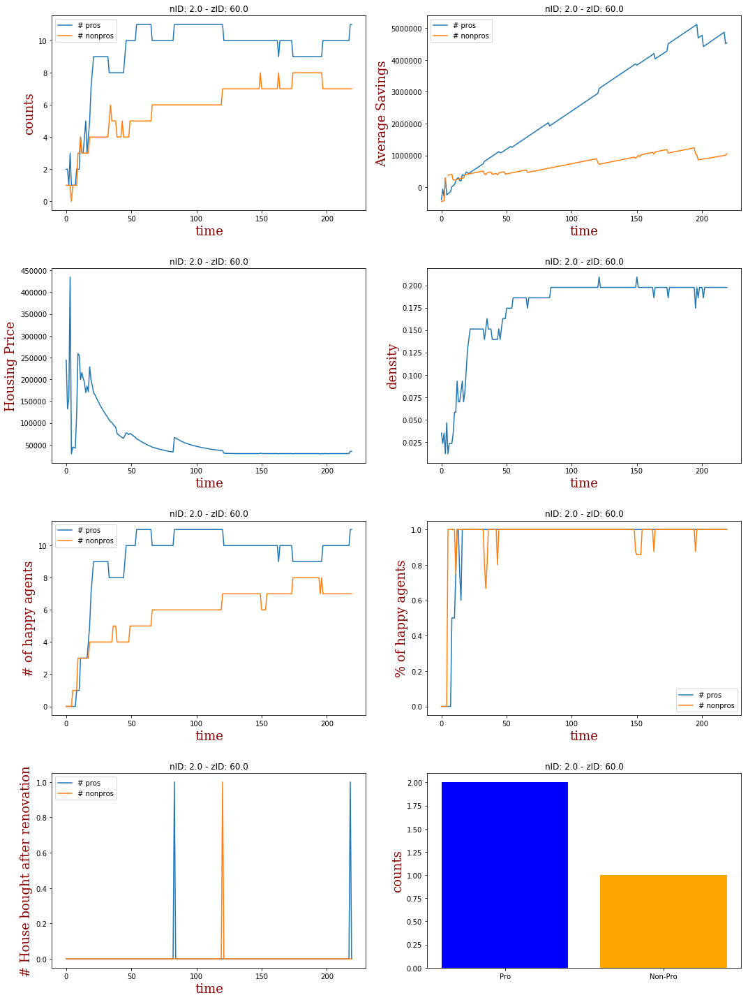

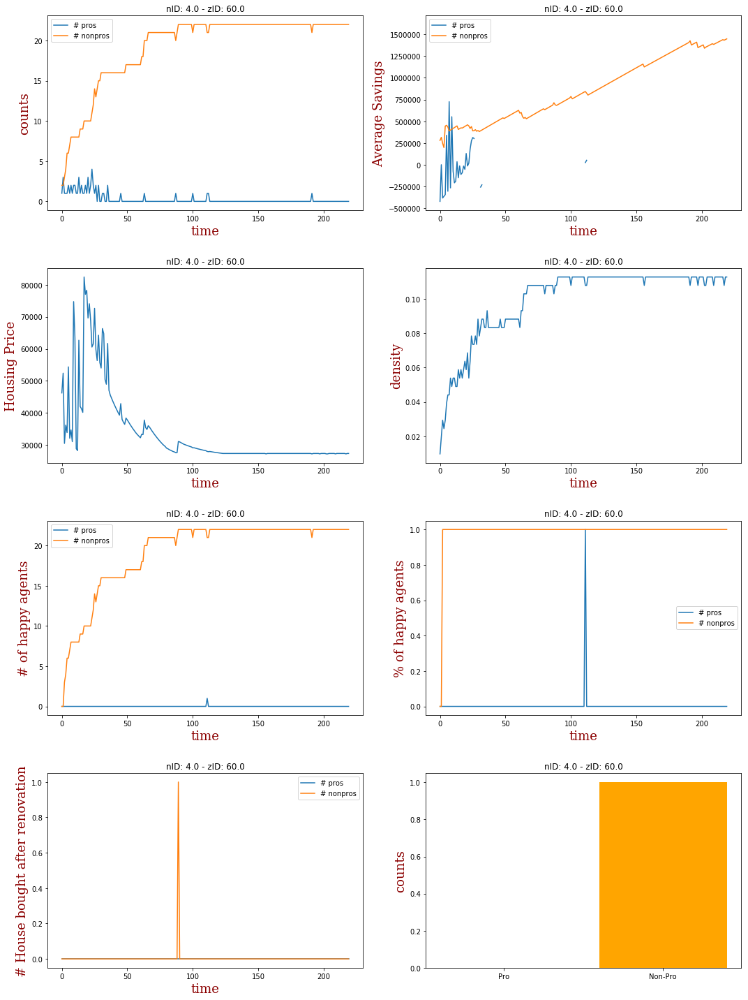

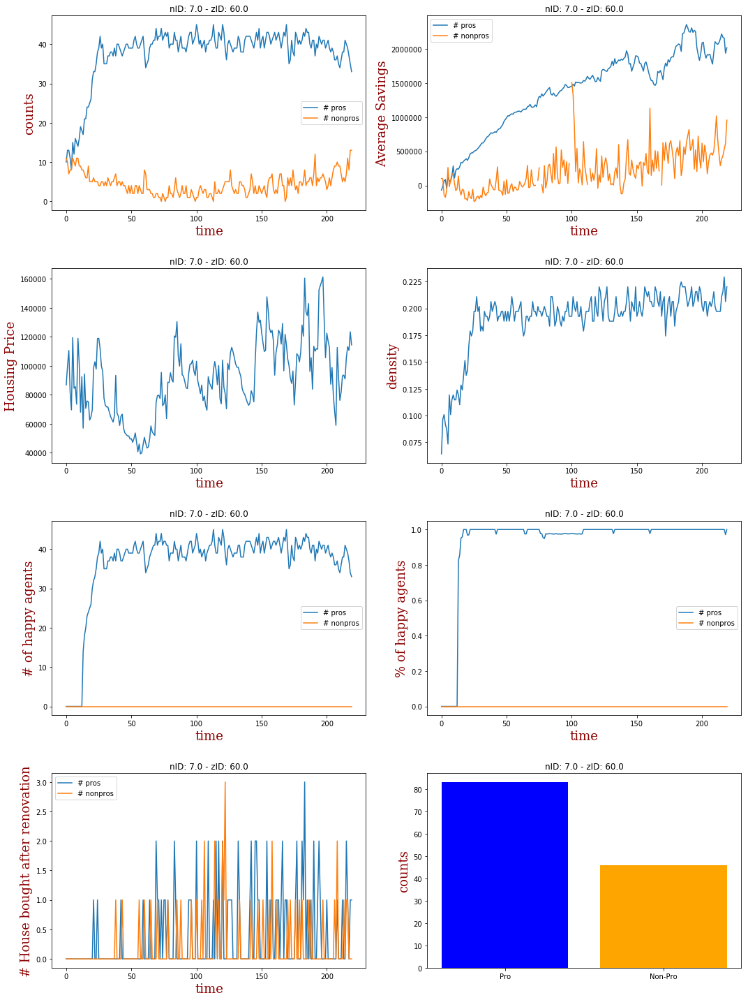

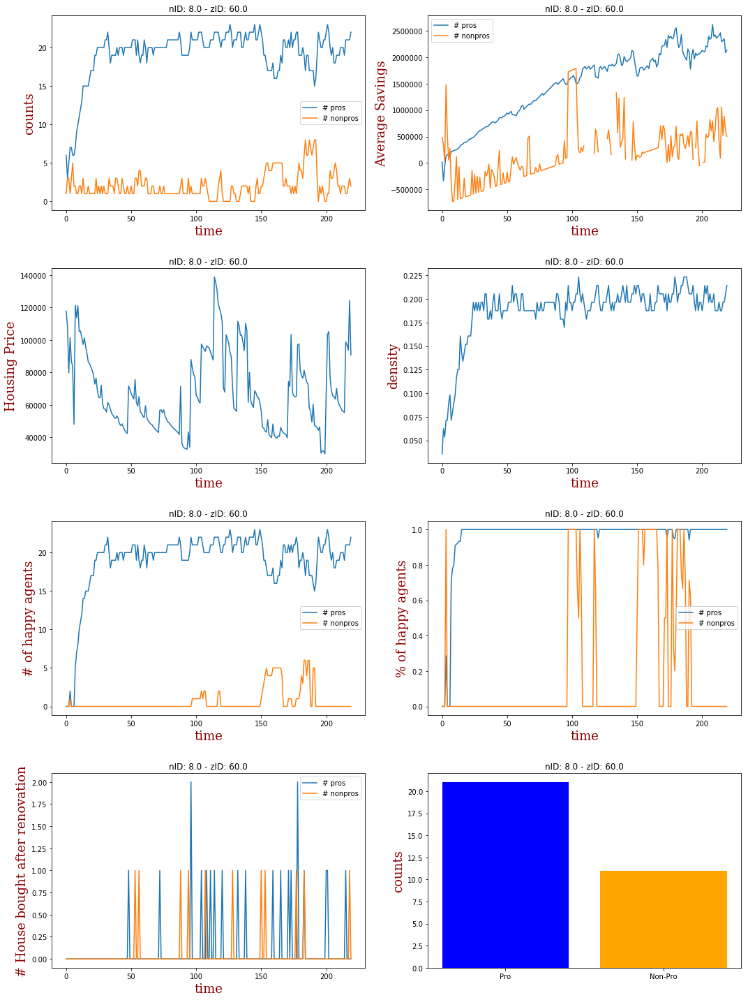

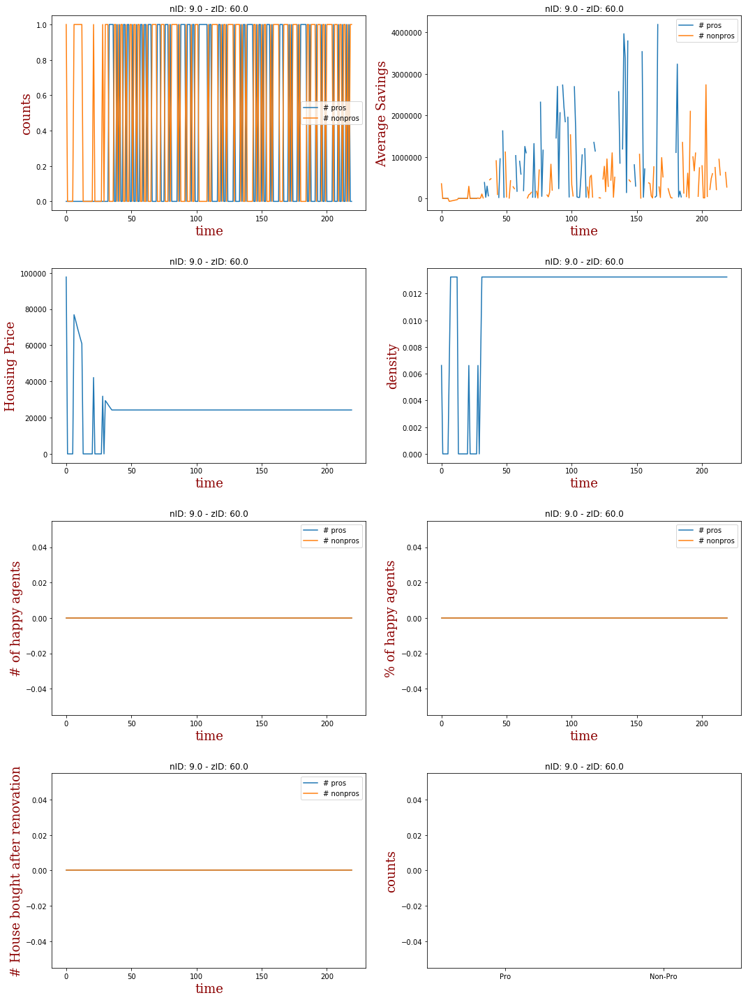

...

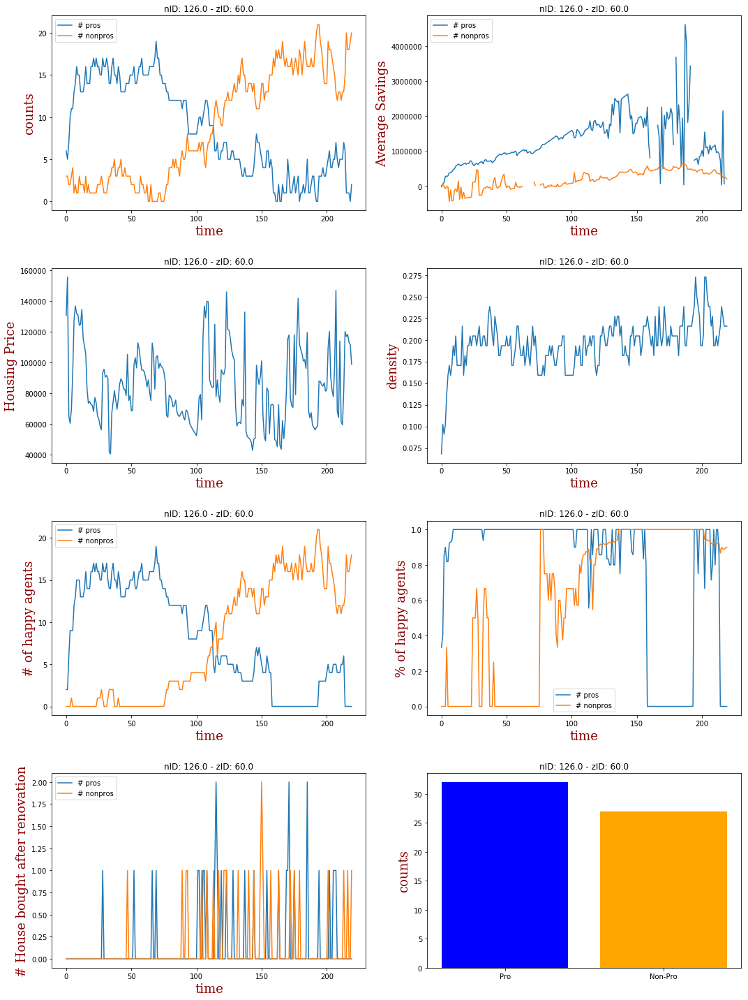

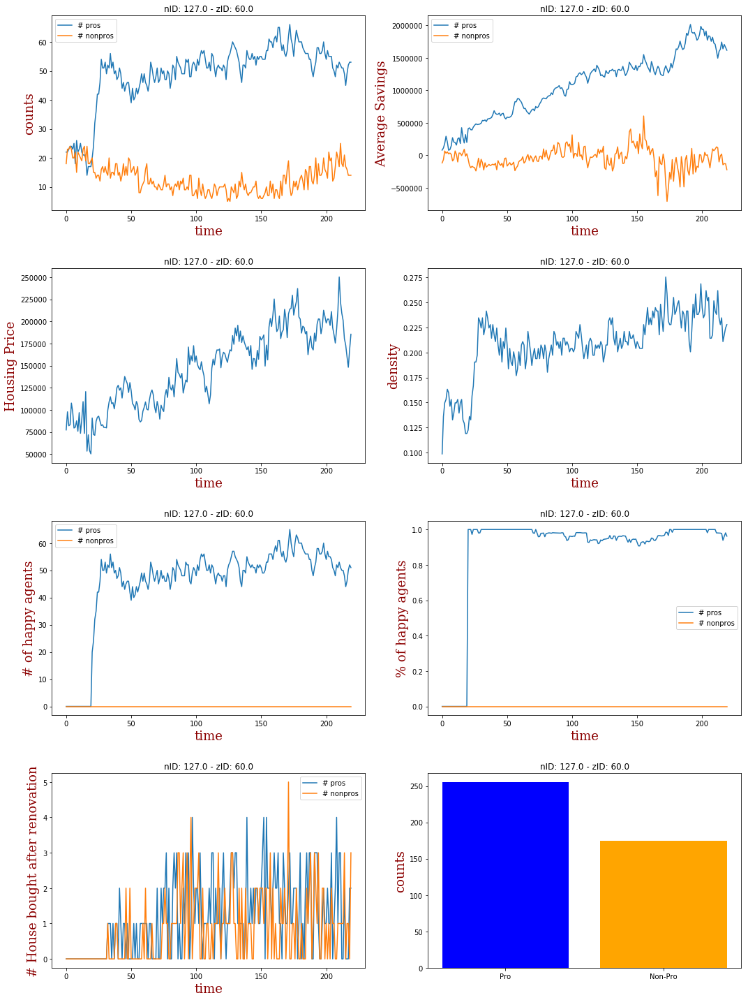

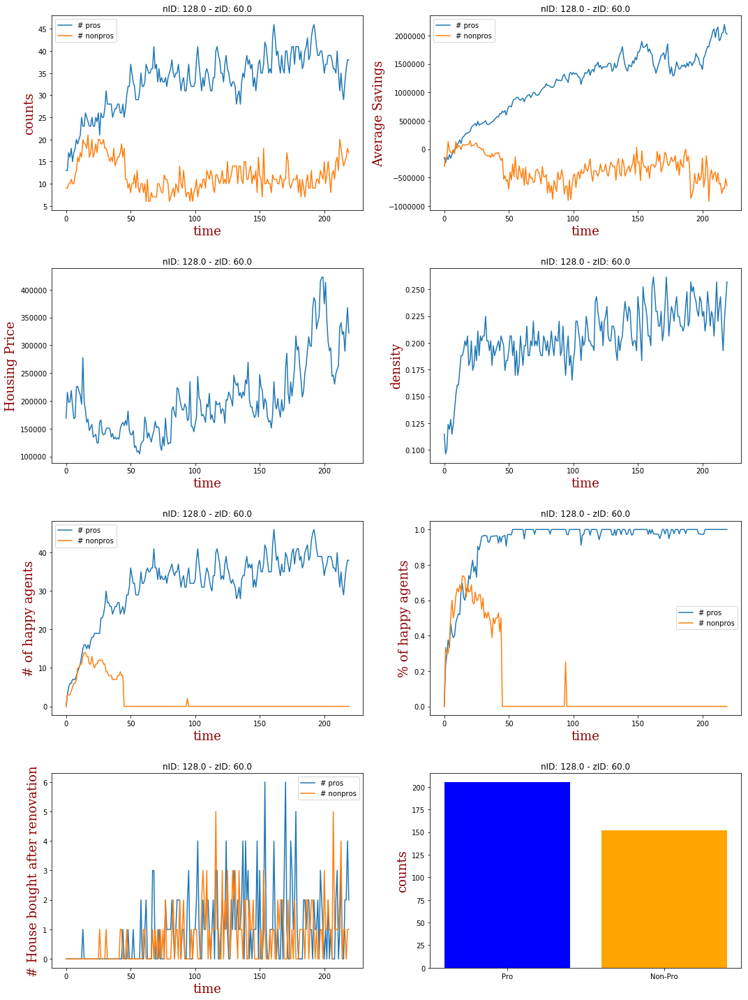

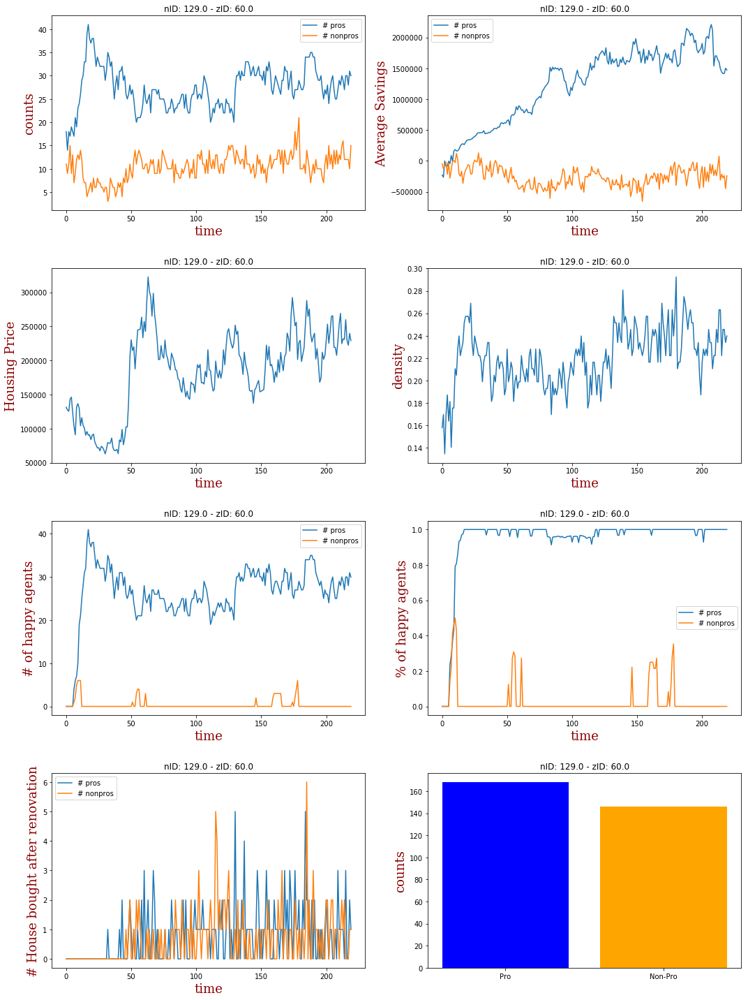

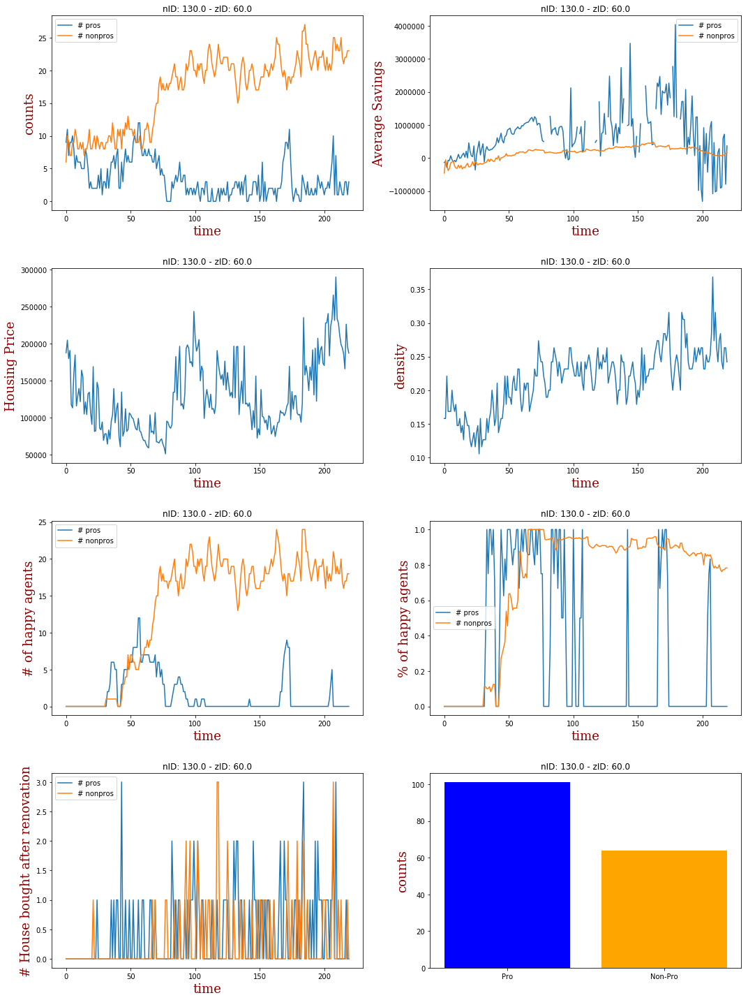

In [198]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 18,
        }

features = ['counts', 'housing']
for feature in features:
    if not os.path.exists('plots/nID/{}/'.format(feature)):
        os.makedirs('plots/nID/{}/'.format(feature))

for key in sorted(stat_pro):
    plt.clf()

    n = max(max([t['tick'] for t in stat_pro[key]]), max([t['tick'] for t in stat_nonpro[key]]))
    zID = merged[merged.nID==key]['zID'].values[0]
    fig = plt.figure(figsize=(15,20))
    
    feature = 'counts'
    ax = fig.add_subplot(4,2,1)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    # moved nonpros
    ax.legend(['# pros', '# nonpros'])
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel(feature,fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))
    
    feature = 'avg_savings'
    ax = fig.add_subplot(4,2,2)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# pros', '# nonpros'])
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel('Average Savings',fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'housing_price'
    ax = fig.add_subplot(4,2,3)
    p_info = np.zeros((n))
    for t in patch_info[key]:
        p_info[t['tick']-1] = t[feature]
    ax.plot(range(n), p_info)
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel('Housing Price', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'density'
    ax = fig.add_subplot(4,2,4)
    p_info = np.zeros((n))
    for t in patch_info[key]:
        p_info[t['tick']-1] = t[feature]
    ax.plot(range(n), p_info)
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel(feature, fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'nhappy'
    ax = fig.add_subplot(4,2,5)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# pros', '# nonpros'])
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel('# of happy agents', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'percentage_happy'
    ax = fig.add_subplot(4,2,6)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# pros', '# nonpros'])
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel('% of happy agents', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    ax = fig.add_subplot(4,2,7)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    if key in pros_bought_house_by_nid:
        for t,v in pros_bought_house_by_nid[key].items():
            f_pro[int(t)-1] = v
    if key in nonpros_bought_house_by_nid:
        for t,v in nonpros_bought_house_by_nid[key].items():
            f_nonpro[int(t)-1] = v
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# pros', '# nonpros'])
    ax.set_xlabel('time',fontdict=font)
    ax.set_ylabel('# House bought after renovation', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    ax = fig.add_subplot(4,2,8)
    f_pro = np.sum(f_pro)
    f_nonpro = np.sum(f_nonpro)
    ax.bar([0,1], [f_pro, f_nonpro], color=('blue', 'orange'))
    ax.set_xticks([0,1])
    ax.set_xticklabels(('Pro', 'Non-Pro'))
    ax.set_ylabel('counts', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    plt.tight_layout()
    plt.savefig('plots/nID/{}-{}.png'.format(zID, key))
    plt.show()